In [1]:
# To get a sense of columns
!csvcut -n "Raw_Data/en.openfoodfacts.org.products.csv"

  1: code	url	creator	created_t	created_datetime	last_modified_t	last_modified_datetime	last_modified_by	last_updated_t	last_updated_datetime	product_name	abbreviated_product_name	generic_name	quantity	packaging	packaging_tags	packaging_en	packaging_text	brands	brands_tags	categories	categories_tags	categories_en	origins	origins_tags	origins_en	manufacturing_places	manufacturing_places_tags	labels	labels_tags	labels_en	emb_codes	emb_codes_tags	first_packaging_code_geo	cities	cities_tags	purchase_places	stores	countries	countries_tags	countries_en	ingredients_text	ingredients_tags	ingredients_analysis_tags	allergens	allergens_en	traces	traces_tags	traces_en	serving_size	serving_quantity	no_nutrition_data	additives_n	additives	additives_tags	additives_en	nutriscore_score	nutriscore_grade	nova_group	pnns_groups_1	pnns_groups_2	food_groups	food_groups_tags	food_groups_en	states	states_tags	states_en	brand_owner	ecoscore_score	ecoscore_grade	nutrient_levels_tags	product_quantity	owner	data_

### Extracting a sample of 100K products 

In [2]:
!head -n 100000 "Raw_Data/en.openfoodfacts.org.products.csv" > Raw_Data/offsample.csv

### Creating a SQLite database for easy data preparation

In [5]:
!csvsql --db sqlite:///OFFdatabase.db --insert Raw_Data/offsample.csv


### Loading Required libraries

In [4]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import sqlite3

In [16]:
conn = sqlite3.connect("OFFdatabase.db")

In [17]:
tables = pd.read_sql("SELECT name FROM sqlite_master WHERE type='table';", conn)
print(tables)

        name
0  offsample


In [24]:
null_count = pd.read_sql("""
    SELECT 
        COUNT(*) AS total_products,
        SUM(CASE WHEN product_name IS NULL THEN 1 END) * 100.0 / COUNT(*) AS product_name_null_percentage,
        SUM(CASE WHEN url IS NULL THEN 1 END) * 100.0 / COUNT(*) AS url_null_percentage,
        SUM(CASE WHEN code IS NULL THEN 1 END) * 100.0 / COUNT(*) AS code_null_percentage,
        SUM(CASE WHEN image_url IS NULL THEN 1 END) * 100.0 / COUNT(*) AS image_url_null_percentage
    FROM 
        offsample
""", conn)
print(null_count)


   total_products  product_name_null_percentage url_null_percentage  \
0           99999                      3.141031                None   

  code_null_percentage  image_url_null_percentage  
0                 None                  50.397504  


##### 3% of products have no names. So we either have to extract it from image, if its available, or remove it from our analysis

In [19]:

df = pd.read_sql("SELECT * FROM offsample", conn)

In [20]:
print("Total attribute counts:", df.shape[1])

Total attribute counts: 206


In [ ]:
def get_attribute_details(df):
    """
    Generate a summary of attributes for each column in the given DataFrame.

    This function analyzes the input DataFrame and returns a new DataFrame
    containing details about each column, including data type, number of null values,
    number of unique values, and percentage of null values.

    Parameters:
    -----------
    df : pandas.DataFrame
        The input DataFrame to analyze.

    Returns:
    --------
    pandas.DataFrame
        A DataFrame with the following columns:
        - data_type: The data type of each column in the input DataFrame.
        - null_values: The count of null (missing) values in each column.
        - unique_values: The count of unique values in each column.
        - null_percentage: The percentage of null values in each column.
    """
    attribute_details = {}
    for col in df.columns:
        attribute_details[col] = {
            'data_type': df[col].dtype,
            'null_values': df[col].isnull().sum(),
            'unique_values': df[col].nunique()
        }
    attribute_df = pd.DataFrame(attribute_details).T
    attribute_df['null_percentage'] = attribute_df['null_values']/len(df)
    return attribute_df

attribute_details = get_attribute_details(df)



In [26]:
len(attribute_details[attribute_details['null_percentage']>0.50].sort_values(by='null_percentage',ascending=False))/len(attribute_details)

0.7475728155339806

##### 74% of columns have more than 50% of null values. Most of them are nutrition related granular information which can be obtained using OCR if images are available

In [23]:
attribute_details[attribute_details['null_percentage']<0.3].sort_values(by='null_percentage',ascending=True)

,data_type,null_values,unique_values,null_percentage
code,float64,0,99574,0.0
url,object,0,99999,0.0
creator,object,0,1100,0.0
created_t,float64,0,74896,0.0
created_datetime,object,0,74896,0.0
last_modified_t,float64,0,75657,0.0
last_modified_datetime,object,0,75657,0.0
completeness,float64,0,56,0.0
states_en,object,0,1294,0.0
states_tags,object,0,1294,0.0


##### Interestingly, Most of the valuable columns have less than 20% of null values as shown in the table above. This makes our analysis less challenging. I've listed out few important columns that we need to investigated further

In [27]:
url_columns = ['url','image_url','image_ingredients_url','image_nutrition_url']
columns_to_investigate = ['product_name','main_category_en','states_en','countries_en','nutriscore_grade','ecoscore_grade','energy_100g','energy-kcal_100g','pnns_groups_1',
                          'pnns_groups_2','completeness','quantity','brands','categories_en','labels_en','ingredients_text','ingredients_analysis_tags']
additional_information = ['serving_size','serving_quantity','additives_n','additives_en','nova_group','food_groups_en']

In [28]:
df[columns_to_investigate].dtypes

product_name                  object
main_category_en              object
states_en                     object
countries_en                  object
nutriscore_grade              object
ecoscore_grade                object
energy_100g                  float64
energy-kcal_100g             float64
pnns_groups_1                 object
pnns_groups_2                 object
completeness                 float64
quantity                      object
brands                        object
categories_en                 object
labels_en                     object
ingredients_text              object
ingredients_analysis_tags     object
dtype: object

In [29]:
def drop_null_rows(df):
    """
    Drop rows with null values in product_name and image_url columns.

    This function removes rows from the input DataFrame where either the
    'product_name' or 'image_url' column contains a null value.

    Parameters:
    -----------
    df : pandas.DataFrame
        The input DataFrame to process.

    Returns:
    --------
    pandas.DataFrame
        A new DataFrame with rows containing null values in 'product_name'
        or 'image_url' columns removed.
    """
    df.dropna(subset=['product_name', 'image_url'], inplace=True)
    
    return df

In [43]:
"Percentage of unique product names",  str(df['product_name'].nunique()/len(df))

('Percentage of unique product names', '0.8059091292253224')

In [31]:
processed_data = drop_null_rows(df)

print("Rows in processed_data:",str(len(processed_data)))
print("Percentage of rows dropped in processed_data:",(len(processed_data)/len(df)))

Rows in processed_data: 47452
Percentage of rows dropped in processed_data: 1.0


In [34]:
def distribution_plot(df, column, num_bin):
    """Plot the distribution of a numerical column"""
    plt.figure(figsize=(10,6))
    sns.histplot(df[column].dropna(), bins=num_bin, kde=True)
    plt.title(f'Distribution of {column}')
    plt.show()

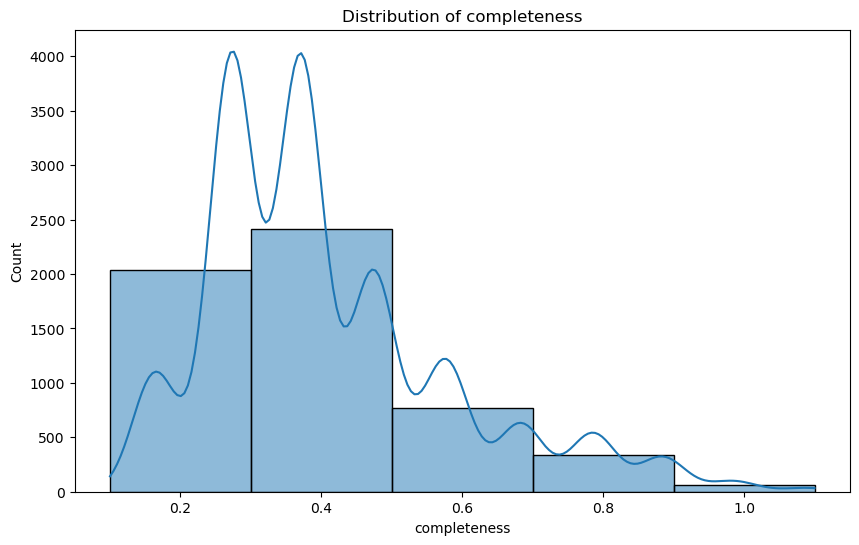

In [40]:
distribution_plot(processed_data,'completeness',5)

##### Majority of the products have less than 50% completeness. This means, we need to rely on images or other existing text features to improve the completeness

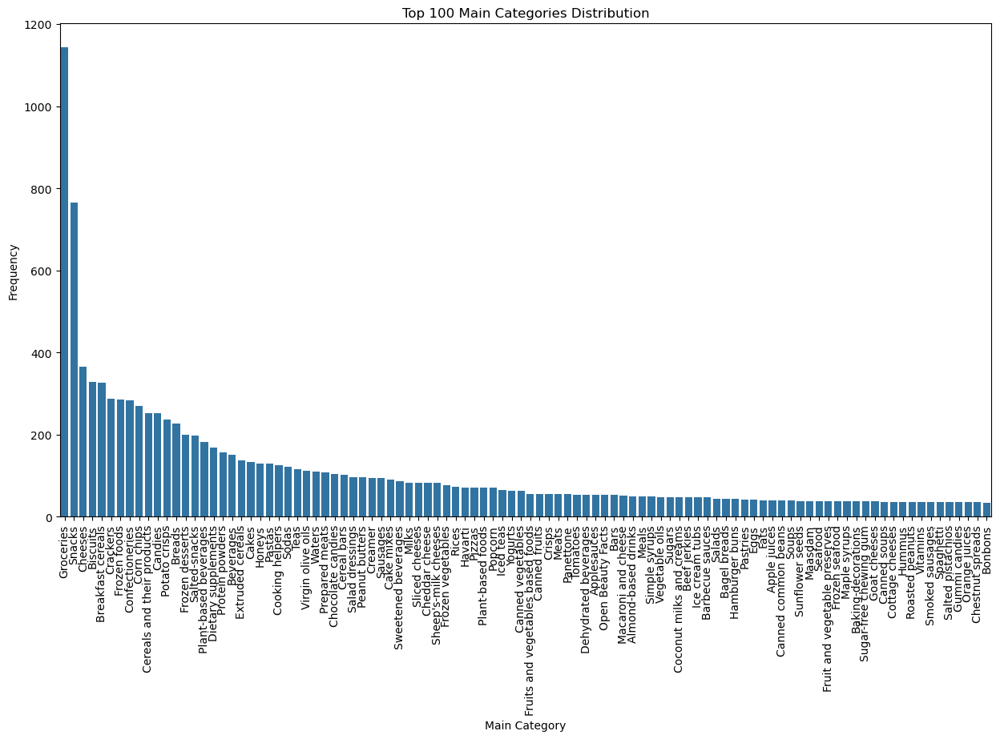

In [35]:
# create bar chart to plot top 20 categories
def bar_graph(top_categories):
    plt.figure(figsize=(15, 8))
    sns.barplot(x=top_categories.index, y=top_categories.values)
    plt.title('Top 100 Main Categories Distribution')
    plt.xlabel('Main Category')
    plt.ylabel('Frequency')
    plt.xticks(rotation=90)
    plt.show()
    
top_categories = df['main_category_en'].value_counts()[:100]
bar_graph(top_categories)

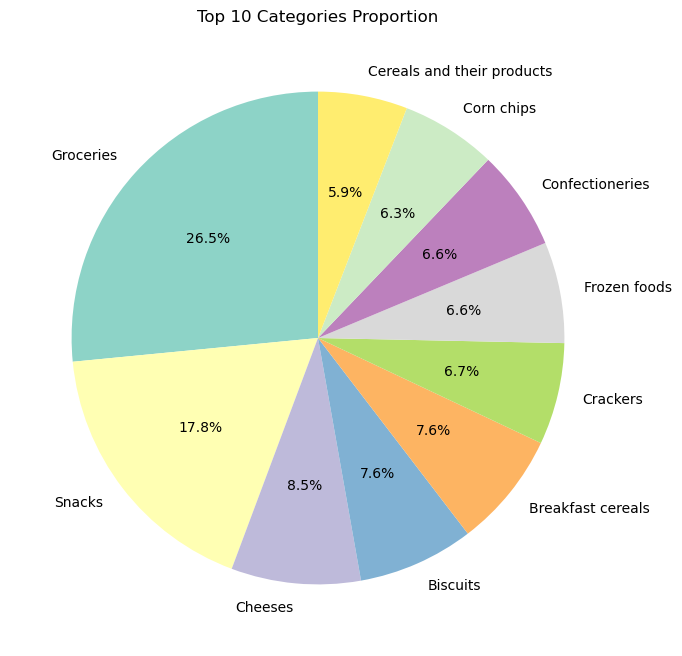

In [68]:
top_10_categories = df['main_category_en'].value_counts().nlargest(10)

plt.figure(figsize=(8, 8))
top_10_categories.plot.pie(autopct='%1.1f%%', startangle=90, cmap='Set3')
plt.title('Top 10 Categories Proportion')
plt.ylabel('')
plt.show()

#### Top 3 categories of products in the data are Groceries, Snacks and Cheeses

In [39]:
def group_stats(df, group_column, target_column):
    """Return statistics for each group in a categorical column"""
    return df.groupby(group_column)[target_column].describe()

energy_per_category = group_stats(processed_data, 'main_category_en','energy-kcal_100g')
energy_per_category = energy_per_category[energy_per_category['count']>5]
energy_per_category.sort_values(by='mean', ascending=False)

,count,mean,std,min,25%,50%,75%,max
main_category_en,,,,,,,,
Canned tunas,14.0,853.042949,2633.326040,94.12,116.5,131.588235,158.985294,10000.000000
Sesame oils,22.0,829.941563,168.118910,120.00,800.0,861.904783,929.000000,929.000000
Olive oils,10.0,804.400000,9.287985,800.00,800.0,800.000000,800.000000,823.000000
Virgin olive oils,108.0,797.504870,118.180909,120.00,800.0,800.000000,823.250000,928.571429
Avocado oils,7.0,784.353741,129.383511,500.00,800.0,800.000000,861.904762,866.666667
...,...,...,...,...,...,...,...,...
Carbonated waters,12.0,0.247536,0.447825,0.00,0.0,0.000000,0.245000,0.996000
Diet sodas,7.0,0.142857,0.377964,0.00,0.0,0.000000,0.000000,1.000000
Drinking water,13.0,0.000000,0.000000,0.00,0.0,0.000000,0.000000,0.000000


##### Canned Tunas, Sesame oils, Olive oils are food rich in calories and Carbonated waters, Diet Sodas, Drinking water are the least calory products

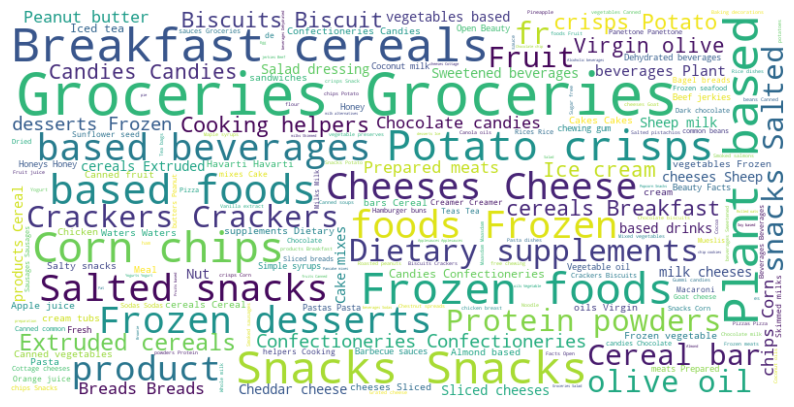

In [70]:
from wordcloud import WordCloud

# Generate a word cloud for main_category_en
text = ' '.join(df['main_category_en'].dropna())

wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

#### Now, Lets concentrate of quantitative analysis of nutritional attributes

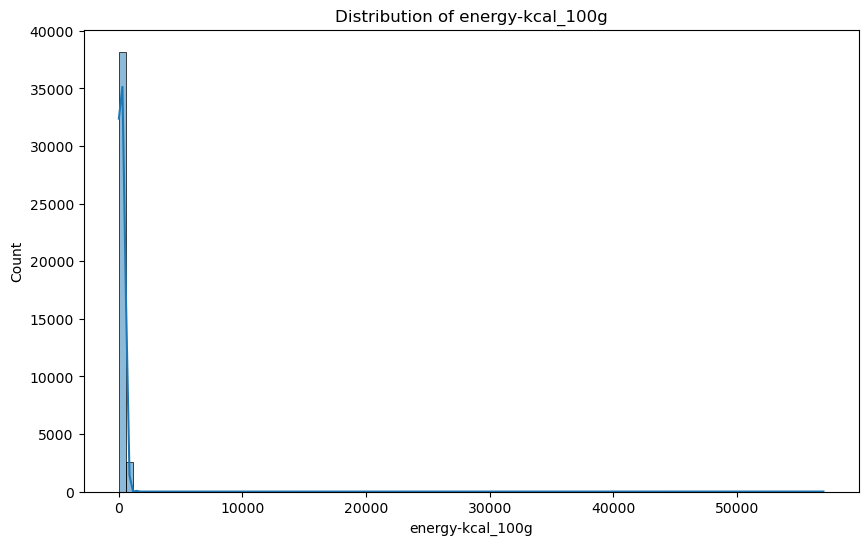

In [48]:
distribution_plot(processed_data,'energy-kcal_100g',100)

In [53]:
processed_data[processed_data['energy-kcal_100g']>1000]['main_category_en'].value_counts()

Protein powders        1
Drink-mix              1
Dietary supplements    1
Breakfasts             1
Ginger                 1
Nuts                   1
Canned tunas           1
Edam                   1
Name: main_category_en, dtype: int64

#### So products with calories > 1000 are possibly outliers in the data. Lets plot the same graph removing these outliers

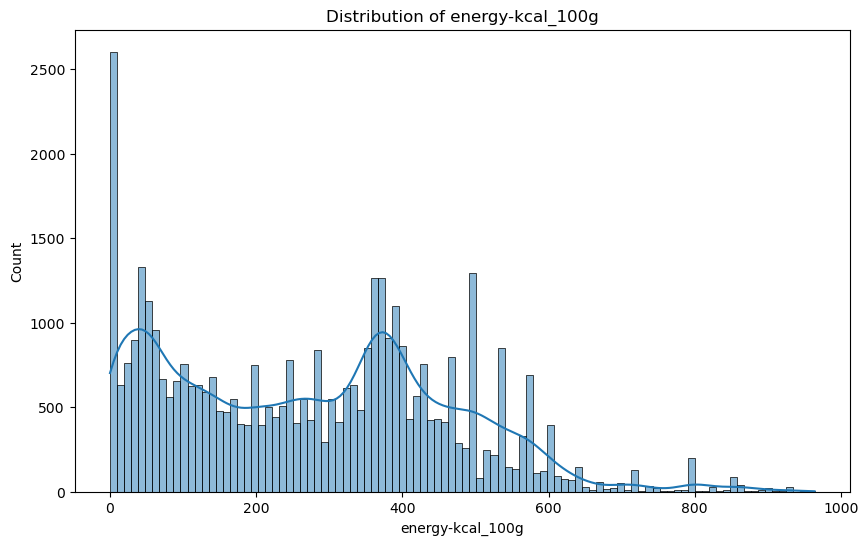

In [54]:
outlier_removed_data = processed_data[processed_data['energy-kcal_100g']<1000]
distribution_plot(outlier_removed_data,'energy-kcal_100g',100)

##### Pretty neat! We can see peak in distribution under 100 Kcal, 400 Kcal.

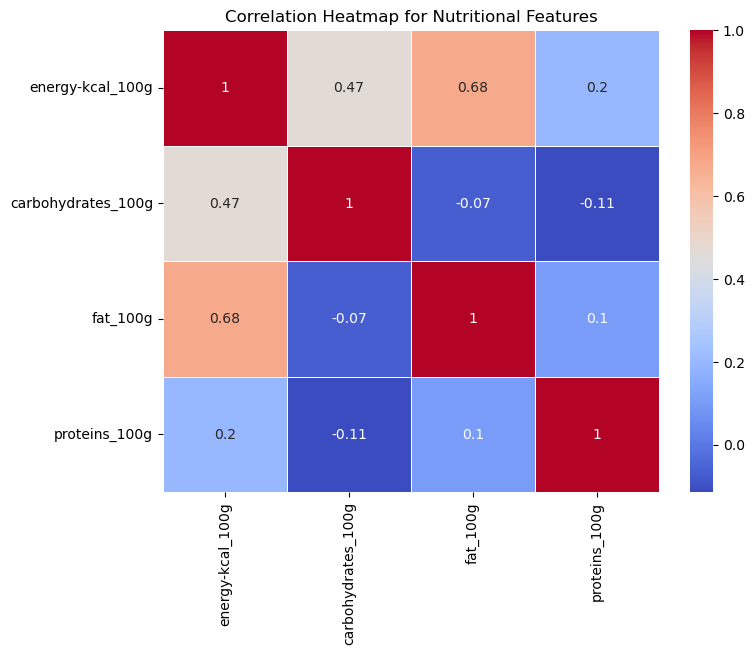

In [61]:
nutritional_columns = ['energy-kcal_100g', 'carbohydrates_100g', 'fat_100g', 'proteins_100g']

# Generate correlation matrix
corr_matrix = outlier_removed_data[nutritional_columns].corr()

# Plot correlation heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap for Nutritional Features')
plt.show()

##### The above heat maps show that there is a strong positive correlation (0.68) between energy (calories) and fat content, meaning that foods with more fat tend to have more calories. Interstingly, it also shows near zero correlation between macro nutrients that means most of the product are rich in only one of the nutrients  

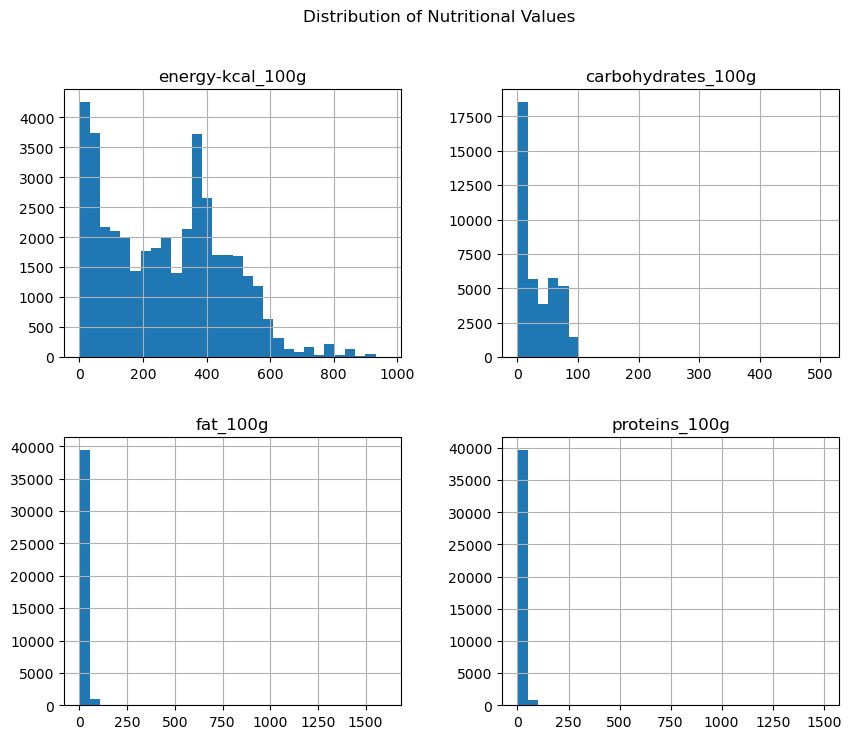

In [64]:
outlier_removed_data[nutritional_columns].hist(bins=30, figsize=(10, 8))
plt.suptitle('Distribution of Nutritional Values')
plt.show()


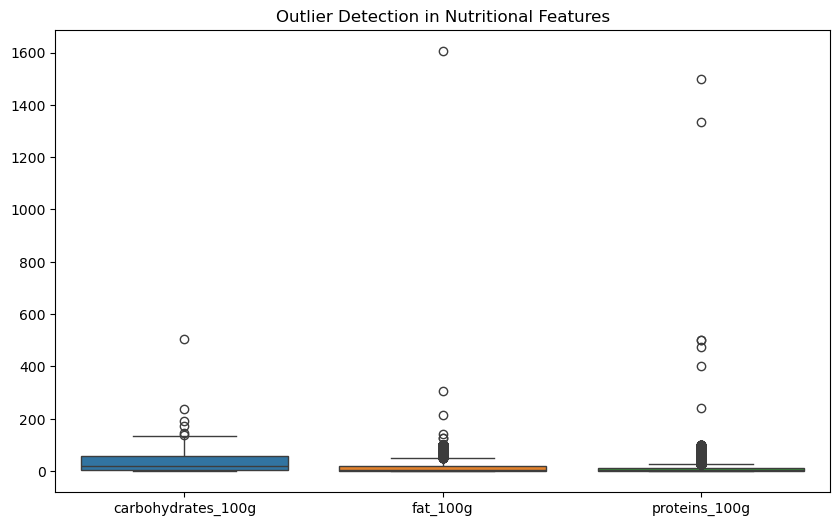

In [66]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=outlier_removed_data[['carbohydrates_100g', 'fat_100g', 'proteins_100g']])
plt.title('Outlier Detection in Nutritional Features')
plt.show()

In [71]:
import scipy.stats as stats

# Perform ANOVA for calories across categories
annova_data = outlier_removed_data[['main_category_en','energy-kcal_100g']].dropna()
annova_data = annova_data.groupby('main_category_en').filter(lambda x: len(x) > 0)
annova_result = stats.f_oneway(*[annova_data[annova_data['main_category_en'] == category]['energy-kcal_100g'] for category in annova_data['main_category_en'].unique()])

print("ANNOVA result for calories across categories:", annova_result)

ANOVA result for calories across categories: F_onewayResult(statistic=18.250886626149946, pvalue=0.0)


##### Annova result shows there is significant variations in calories between products. This says the dataset contain wide variety of products

In [150]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd

tukeyhsd = pairwise_tukeyhsd(endog=annova_data['energy-kcal_100g'],
                              groups=annova_data['main_category_en'],
                              alpha=0.05)
print(tukeyhsd)

                                          Multiple Comparison of Means - Tukey HSD, FWER=0.05                                           
                    group1                                        group2                     meandiff p-adj    lower      upper   reject
----------------------------------------------------------------------------------------------------------------------------------------
                                    Abondance                                  Agave syrups       3.0    1.0  -775.9781  781.9781  False
                                    Abondance                                Almond butters    259.25    1.0  -519.7281 1038.2281  False
                                    Abondance                                  Almond paste      19.0    1.0  -655.6149  693.6149  False
                                    Abondance                                       Almonds  169.6667    1.0  -609.3115  948.6448  False
                                    Abond

In [72]:
country_wise_stats = outlier_removed_data.groupby('countries_en')[nutritional_columns].mean().reset_index()

country_product_counts = outlier_removed_data['countries_en'].value_counts().reset_index()
country_product_counts.columns = ['countries_en', 'product_count']
country_wise_stats = pd.merge(country_wise_stats, country_product_counts, on='countries_en', how='left')
country_wise_stats = country_wise_stats[country_wise_stats['product_count']>3]

In [73]:
for column in nutritional_columns:
    country_wise_stats[f'{column}_normalized'] = country_wise_stats[column] / country_wise_stats['product_count']
country_wise_stats

,countries_en,energy-kcal_100g,carbohydrates_100g,fat_100g,proteins_100g,product_count,energy-kcal_100g_normalized,carbohydrates_100g_normalized,fat_100g_normalized,proteins_100g_normalized
1,Andorra,309.461538,4.669231,24.700000,18.861538,13,23.804734,0.359172,1.900000,1.450888
7,Aruba,209.124579,38.933502,6.347778,5.875926,6,34.854097,6.488917,1.057963,0.979321
8,Australia,231.470908,33.986968,8.019968,6.461076,34,6.807968,0.999617,0.235881,0.190032
19,Austria,287.342857,44.860000,5.214286,11.452571,5,57.468571,8.972000,1.042857,2.290514
27,Bahrain,224.857143,21.668203,13.829493,1.428571,7,32.122449,3.095458,1.975642,0.204082
...,...,...,...,...,...,...,...,...,...,...
344,"United States,World",276.289253,39.893572,10.972493,7.024095,1474,0.187442,0.027065,0.007444,0.004765
349,Virgin Islands of the United States,236.136559,35.302949,7.294920,6.719477,8,29.517070,4.412869,0.911865,0.839935
350,World,293.236129,44.282712,10.527373,8.762745,7,41.890876,6.326102,1.503910,1.251821
351,"World,Estados-unidos",240.833333,51.616667,3.026667,2.933333,6,40.138889,8.602778,0.504444,0.488889


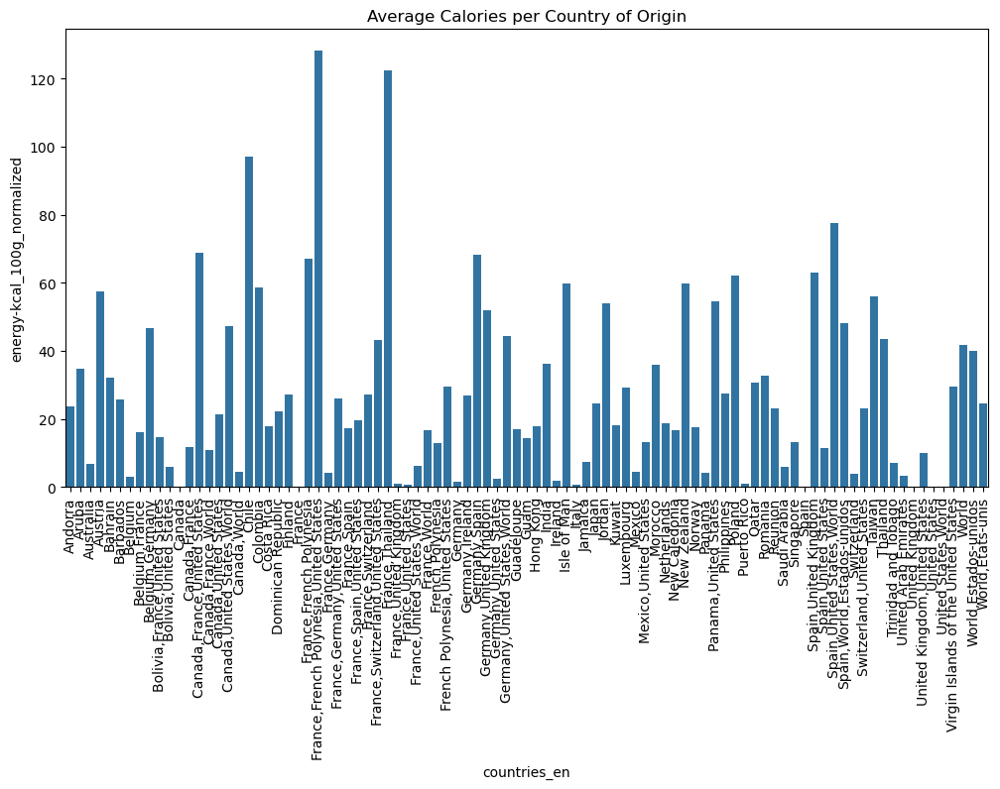

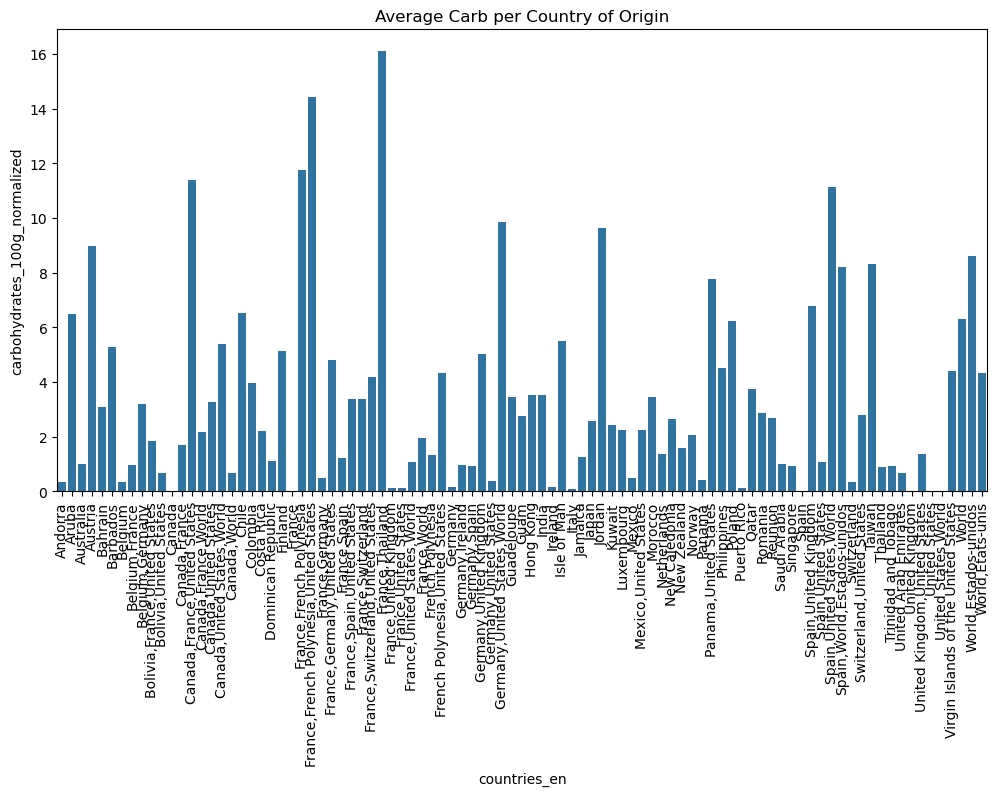

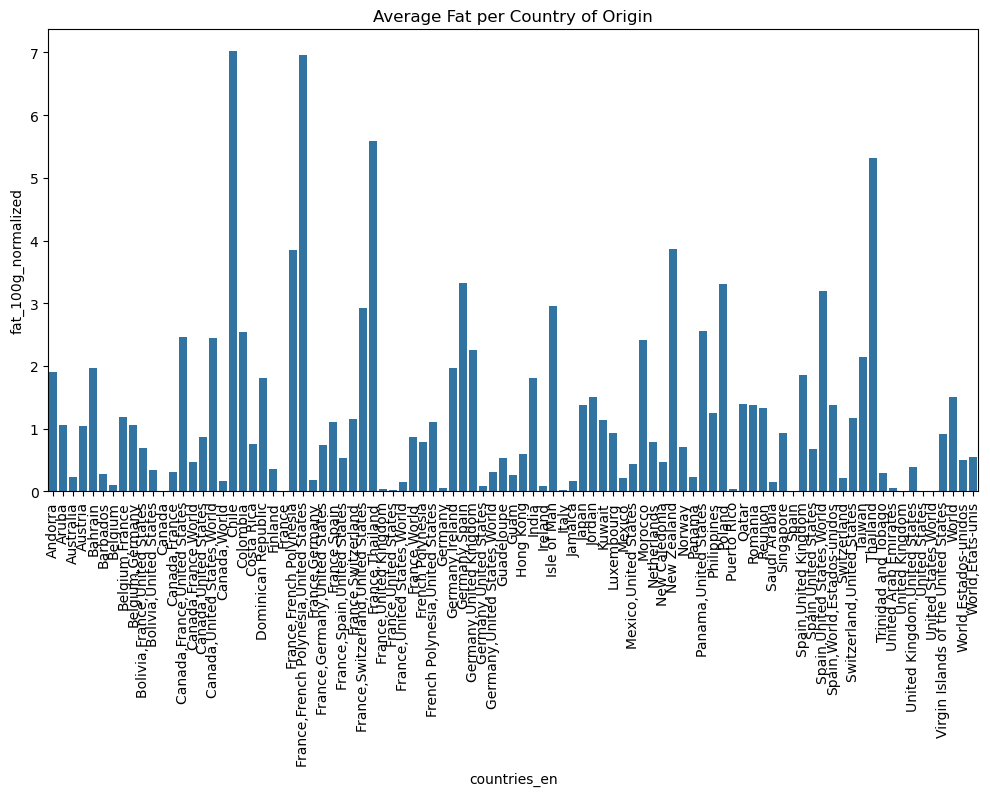

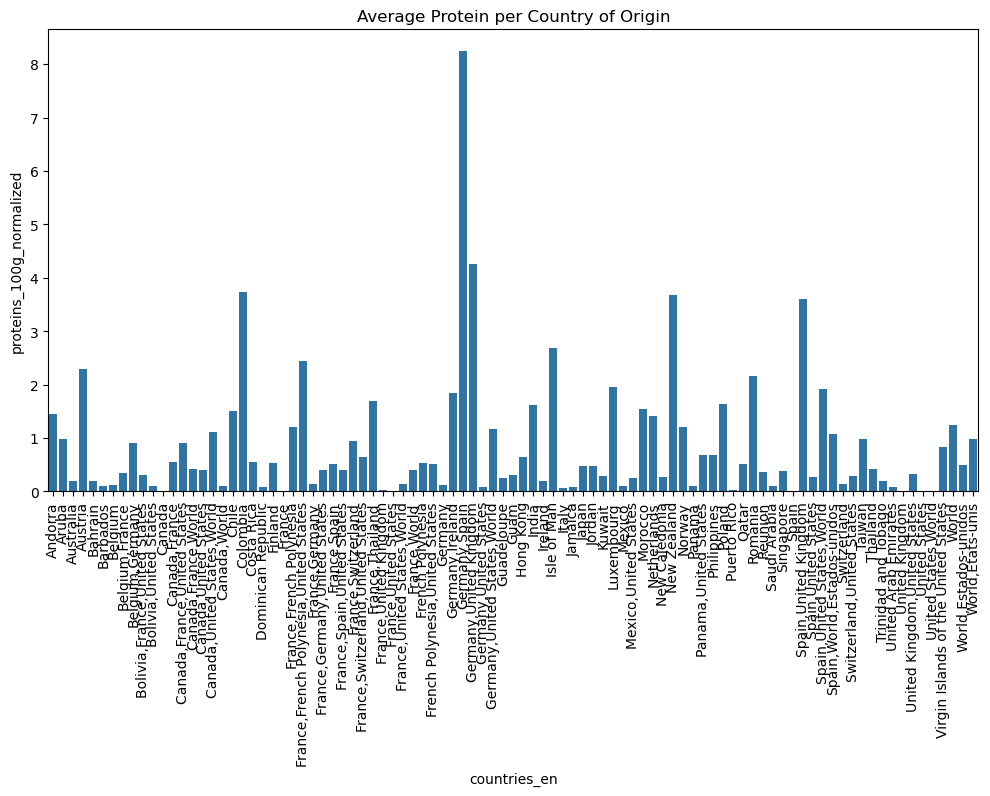

In [75]:
plt.figure(figsize=(12, 6))
sns.barplot(x='countries_en', y='energy-kcal_100g_normalized', data=country_wise_stats)
plt.xticks(rotation=90)
plt.title('Average Calories per Country of Origin')
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(x='countries_en', y='carbohydrates_100g_normalized', data=country_wise_stats)
plt.xticks(rotation=90)
plt.title('Average Carb per Country of Origin')
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(x='countries_en', y='fat_100g_normalized', data=country_wise_stats)
plt.xticks(rotation=90)
plt.title('Average Fat per Country of Origin')
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(x='countries_en', y='proteins_100g_normalized', data=country_wise_stats)
plt.xticks(rotation=90)
plt.title('Average Protein per Country of Origin')
plt.show()

##### These plot shows there are significant variations in the average calory food manufactured/consumed by various countries. Countries like France, US, Italy are associated with high calory food products that are rich in Carbs and fats. However, certain products are mutliple country attribution which challenge us in providing sold inference from the data. 